## Диффузионные модели

Существуют свободно доступные модели генерации изображений с открытыми весами, такие, как [Stable Diffusion](https://huggingface.co/stabilityai/stable-diffusion-3.5-large), [Kandinsky](https://huggingface.co/ai-forever/Kandinsky3.1) и [FLUX](https://huggingface.co/black-forest-labs/FLUX.1-dev).

Наиболее известная библиотека для работы с такими моделями - diffusers. Сами модели доступны на [HuggingFace](https://huggingface.co), где также есть примеры кода. Посмотрим, как просто сгенерировать изображение с помощью Stable Diffusion XL.

Для начала загружаем модель и перемещаем её на GPU с помощью `.to("cuda")`. Без GPU генерация будет очень долгой.

In [ ]:
%pip install -q shwarsutils

  Preparing metadata (setup.py) ... done


In [ ]:
import torch
from diffusers import AutoPipelineForText2Image

model_id = "stabilityai/stable-diffusion-xl-base-1.0"

pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16")
pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.32.2",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

Теперь собственно запускаем генерацию. Параметр `num_inference_steps` задаёт число шагов denoise, `guidance_scale` - компромисс между метрикой "натуральности" изображения и его близостью к пропмту.

  0%|          | 0/30 [00:00<?, ?it/s]

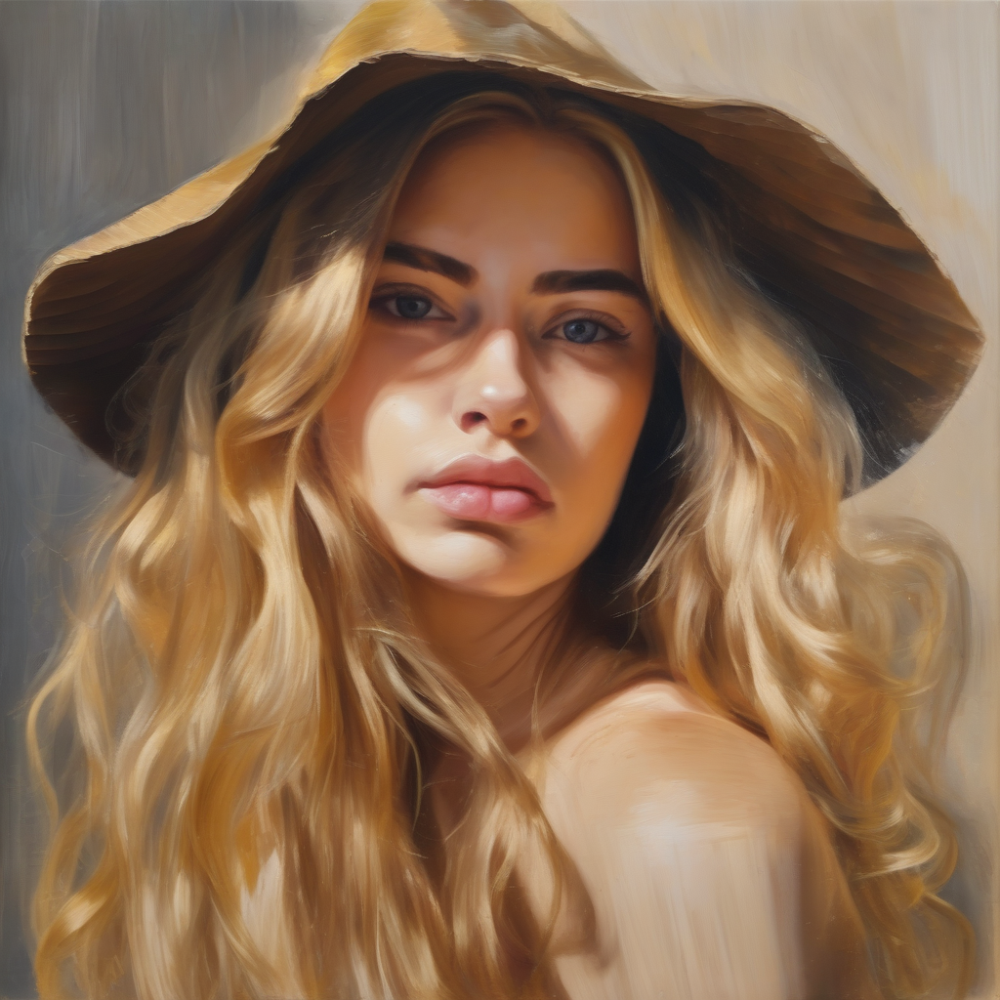

In [ ]:
prompt = "Self-portrait oil painting, a beautiful girl with golden hair, 8k"

images = pipe(prompt=prompt, num_inference_steps=30, guidance_scale=7.5).images
images[0]

На самом деле мы можем проследить, как процесс генерации работает по шагам:

1. Получаем эмбеддинг текстового запроса (в случае SDXL мы оперируем двумя векторами - самим эмбеддингом `embed` и его усреднённым значением `pooled_embed`.
2. Генерируем белый шум нужной размерности. Если мы хотим изображение размером 1024, то пространственную размерность тензора шума нужно уменьшить на значение `vae_scale_factor`.
3. Запускаем генерацию с помощью вызова `pipe`, в ходе этого процесса будет нужно количество раз запущен процесс удаления шума.

<ipython-input-3-63c7d57c991c>:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  lat_shape = (1, pipe.unet.in_channels, 1024 // pipe.vae_scale_factor, 1024 // pipe.vae_scale_factor)


  0%|          | 0/50 [00:00<?, ?it/s]

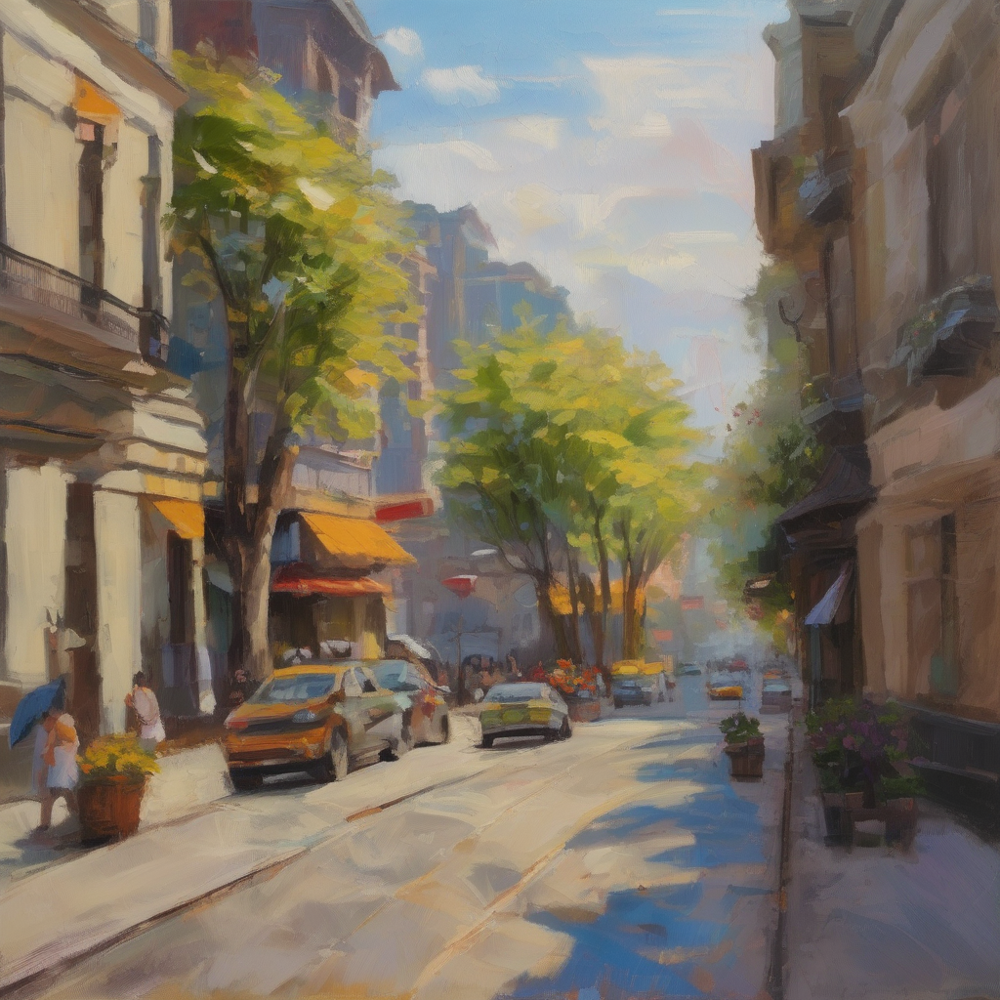

In [ ]:
prompt = "oil painting of summer city landscape"

# Получение вектора смысла запроса
embed,_,pooled_embed,_ = pipe.encode_prompt(prompt)

# Получение входного шума
lat_shape = (1, pipe.unet.in_channels, 1024 // pipe.vae_scale_factor, 1024 // pipe.vae_scale_factor)
latents = torch.randn(lat_shape,dtype=pipe.unet.dtype)

# Генерация картинки
images = pipe(prompt_embeds=embed,pooled_prompt_embeds=pooled_embed,latents=latents).images
images[0]

## Нейровидео

На основе предыдущего примера мы можем сгенерировать нейровидео, в котором изображение из одного запроса "перетекает" в другой. Для этого сгенерируем два текстовых эмбеддинга, и далее будем интерпролировать вектора эмбеддингов и генерировать промежуточные кадры видео.

In [ ]:
prompt1 = "oil painting of young girl in front of summer city landscape"
prompt2 = "oil painting of old woman in front of winter village landscape"

# Получение вектора смысла запроса
embed1,_,pooled_embed1,_ = pipe.encode_prompt(prompt1)
embed2,_,pooled_embed2,_ = pipe.encode_prompt(prompt2)

# Получение входного шума
lat_shape = (1, pipe.unet.in_channels, 1024 // pipe.vae_scale_factor, 1024 // pipe.vae_scale_factor)
latents = torch.randn(lat_shape,dtype=pipe.unet.dtype)

# Генерация картинки
for i in range(50):
  embed = embed1 + (embed2-embed1)*i/50
  pooled_embed = pooled_embed1 + (pooled_embed2-pooled_embed1)*i/50
  images = pipe(prompt_embeds=embed,pooled_prompt_embeds=pooled_embed,latents=latents,num_inference_steps=25).images
  images[0].save(f'frame_{i}.jpg')

<ipython-input-4-2ad1b7da8f5a>:9: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  lat_shape = (1, pipe.unet.in_channels, 1024 // pipe.vae_scale_factor, 1024 // pipe.vae_scale_factor)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Все полученные кадры можно объединить вместе с помощью утилиты `ffmpeg`:

In [ ]:
!ffmpeg -r 15 -i frame_%d.jpg -c:v libx264 -vf fps=25 -pix_fmt yuv420p out.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

## Image-to-Image

Генеративные нейросети могут также работать в режиме Image to Image - когда помимо промпта задается также изображение, по которому рисуется результат. Для начала возьмём какое-нибудь изображение:

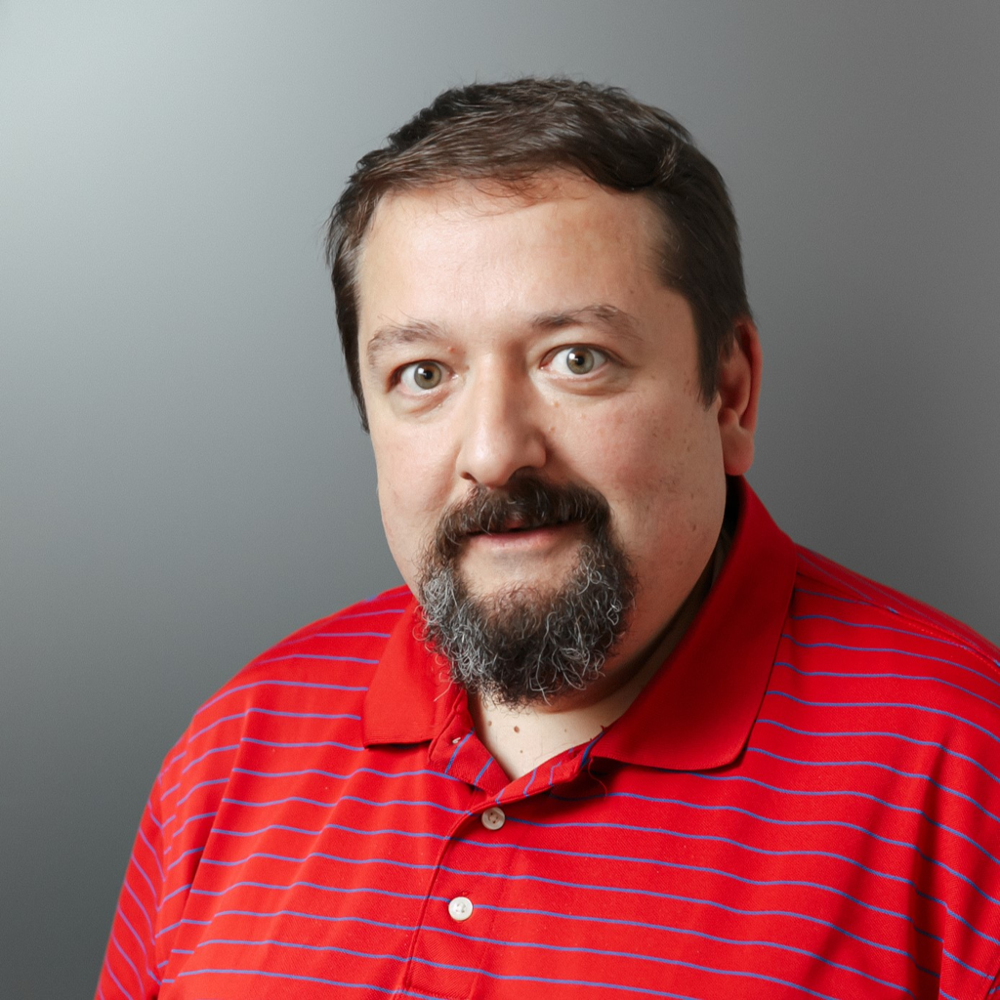

In [ ]:
from shwars.utils import *
img = image_from_url("https://soshnikov.com/images/official/shwars_studio.jpg").resize((1024,1024))
img

Теперь загрузим стилизованную модель [Inkpunk Diffusion](https://huggingface.co/Envvi/Inkpunk-Diffusion) в режиме Image to Image Pipeline. В инструкции к модели написано, что нужно использовать в промпте ключевое слово **nvinkpunk**

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

diffusion_pytorch_model.bin:   9%|8         | 294M/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:  88%|########8 | 295M/335M [00:00<?, ?B/s]

pytorch_model.bin:  62%|######1   | 304M/492M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--Envvi--Inkpunk-Diffusion/snapshots/b491aaca6d312daf751e76dbf2b3eedf8cb91c7b/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--Envvi--Inkpunk-Diffusion/snapshots/b491aaca6d312daf751e76dbf2b3eedf8cb91c7b/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--Envvi--Inkpunk-Diffusion/snapshots/b491aaca6d312daf751e76dbf2b3eedf8cb91c7b/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--Envvi--Inkpunk-Diffusion/snapshots/b491aaca6d312daf751e76dbf2b3eedf8cb91c7b/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2im

  0%|          | 0/5 [00:00<?, ?it/s]

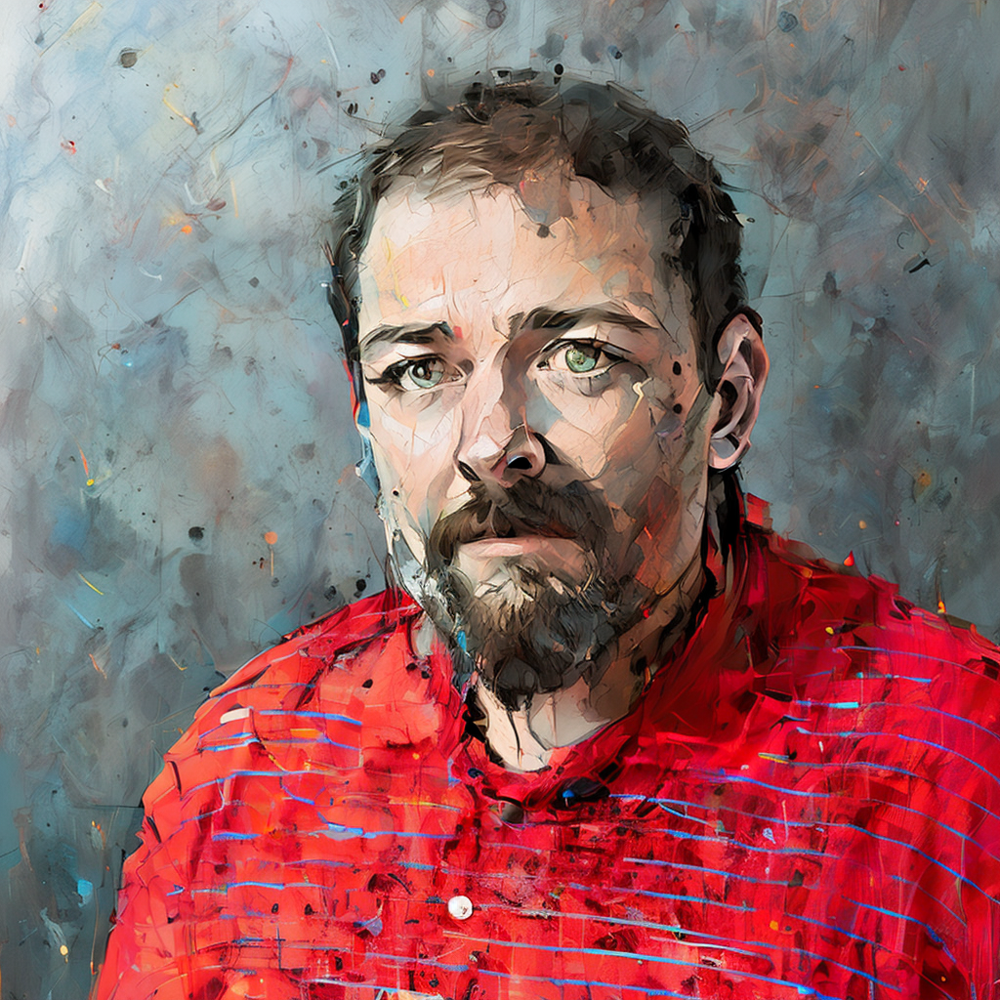

In [ ]:
import torch
from diffusers import AutoPipelineForImage2Image

model_id = "Envvi/Inkpunk-Diffusion"

pipe = AutoPipelineForImage2Image.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
pipe.to("cuda")

prompt = "Portrait of a man, 8k, nvinkpunk"

image = pipe(image=img, strength=0.5, prompt=prompt, num_inference_steps=20, guidance_scale=7.5).images[0]
image

С помощью программирования мы можем применить режим рисования Image-to-Image к видео покадровым образом. Для работы с видео будем использовать библиотеку `imageio`, которая позволяет открыть видеофайл на чтение и запись покадрово.

In [ ]:
!wget http://www.soshnikov.com/permanent/data/vickie_room.mp4

--2025-02-17 09:25:12--  http://www.soshnikov.com/permanent/data/vickie_room.mp4
Resolving www.soshnikov.com (www.soshnikov.com)... 79.137.227.122
Connecting to www.soshnikov.com (www.soshnikov.com)|79.137.227.122|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1677832 (1.6M) [text/plain]
Saving to: ‘vickie_room.mp4’

vickie_room.mp4     100%[===================>]   1.60M  89.1KB/s    in 16s     

2025-02-17 09:25:30 (102 KB/s) - ‘vickie_room.mp4’ saved [1677832/1677832]



In [ ]:
import numpy as np
import imageio as iio
from shwars.utils import *

prompt = "Self-portrait oil painting of a business woman, 8k, nvinkpunk"
video = iio.get_reader('vickie_room.mp4', 'ffmpeg', fps=15)
out = iio.get_writer('vickie_room_sd.mp4', 'ffmpeg', fps=15)
fms = []
res = []
for i,x in enumerate(video):
  fms.append(x.astype(np.float32)/255)
  image = pipe(image=x.astype(np.float32)/255, strength=0.5, prompt=prompt, num_inference_steps=10, guidance_scale=7.5).images[0]
  res.append(image)
  out.append_data(np.array(image))

out.close()

display_images(res[::30])

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

## До-обучение моделей и LoRA

До-обучать модели можно на на сравнительно небольшом объеме изображений. До-обучать можно:

* на новые стили
* на новые объекты

Для экономного до-обучения используется техника LoRA (Low Rank Adaptation), когда мы до-обучаем не все веса нейросети, а только небольшую "дельту".

Загрузить и применить LoRA можно несколькими строчками кода:

In [ ]:
import torch
from diffusers import AutoPipelineForText2Image

model_id = "stabilityai/stable-diffusion-xl-base-1.0"

pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16")
pipe.to("cuda")

pipe.load_lora_weights("imagepipeline/InkPunk-XL")
pipe.fuse_lora()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

(…)-9722-4be9-9fc4-9270be4f0f22.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

  0%|          | 0/25 [00:00<?, ?it/s]

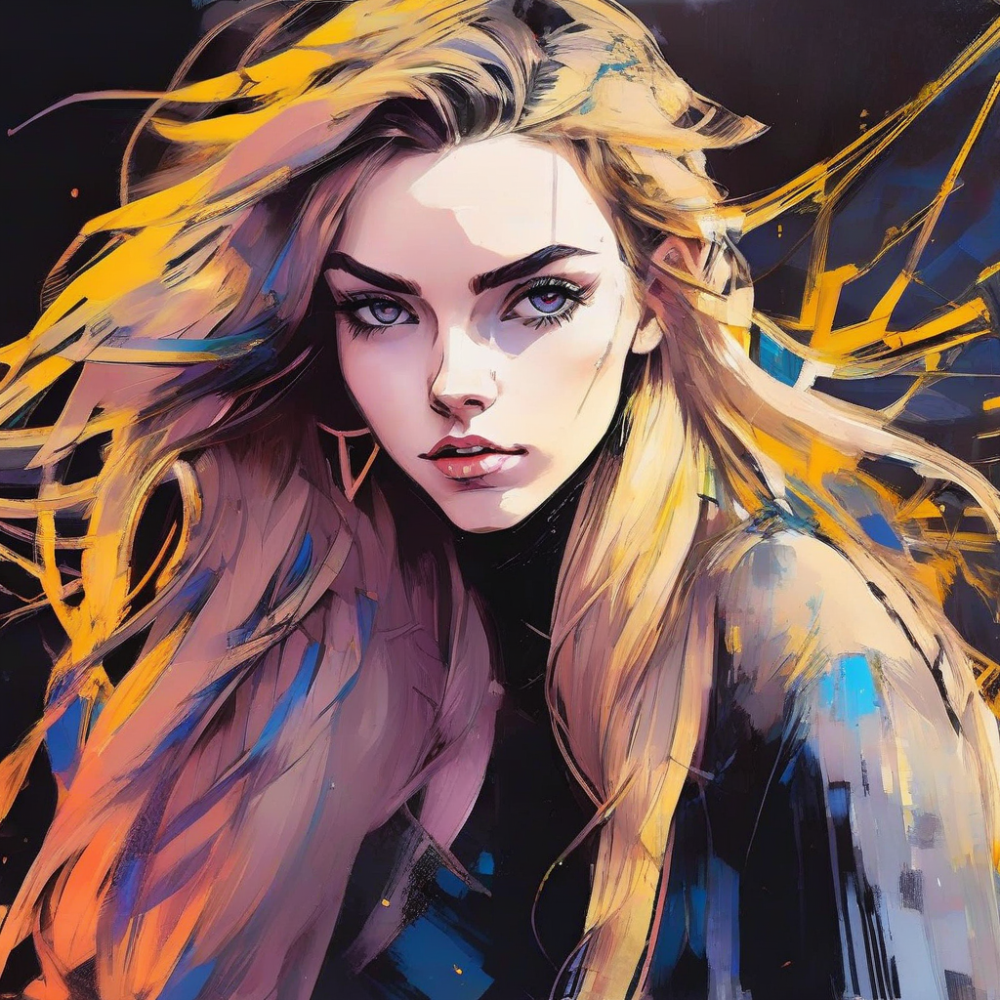

In [ ]:
prompt = "Self-portrait oil painting, a beautiful girl with golden hair, 8k"
images = pipe(prompt="inkpunk style illustration,"+prompt, num_inference_steps=25).images
images[0]

Интересная идея, реализованная также в виде LoRA - это возможность генерации качественного изображения за 1-2 шага. Для этого используют дистилляцию - уже обученную полноценную модель используют в качестве учителя, обучая дочернюю модель удалять шум за 1-2 шага.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


pytorch_lora_weights.safetensors:   0%|          | 0.00/394M [00:00<?, ?B/s]

  0%|          | 0/2 [00:00<?, ?it/s]

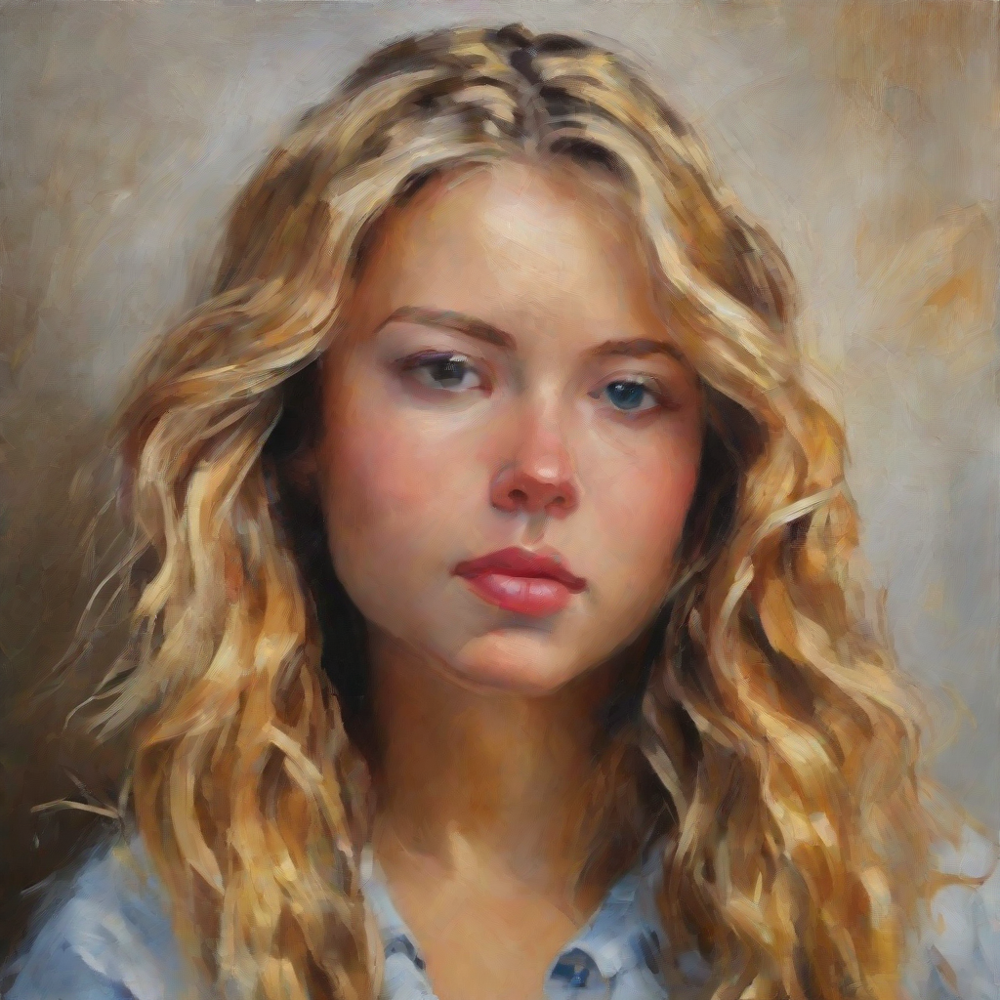

In [ ]:
import torch
from diffusers import LCMScheduler, AutoPipelineForText2Image

model_id = "stabilityai/stable-diffusion-xl-base-1.0"
adapter_id = "latent-consistency/lcm-lora-sdxl"

pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16")
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)
pipe.to("cuda")

# load and fuse lcm lora
pipe.load_lora_weights(adapter_id)
pipe.fuse_lora()

prompt = "Self-portrait oil painting, a beautiful girl with golden hair, 8k"

images = pipe(prompt=prompt, num_inference_steps=2, guidance_scale=0).images
images[0]

Попробуем сделать серию работ - девушек с разными цветами волос в соответствии с цветами радуги:

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

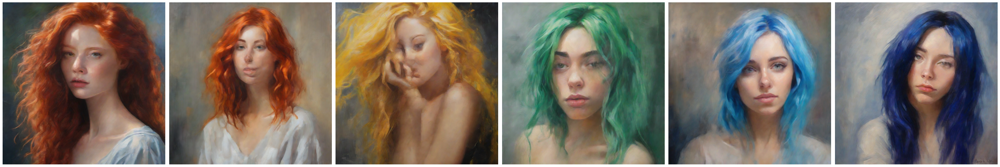

In [ ]:
from shwars.utils import *

colors = ['red','orange','yellow','green','blue','indigo']
res = []
for c in colors:
  image = pipe(prompt=f"oil painting of a beautiful girl with {c} hair, looking with attention into the camera, 8k", num_inference_steps=2, guidance_scale=0).images[0]
  res.append(image)

display_images(res)

Здесь мы видим небольщую проблему - позы получаются разными, из-за этого вся серия смотрится не очень хорошо.

## ControlNet

Для контроля позы на изображении можно использовать технику [ControlNet](https://github.com/lllyasviel/ControlNet). Для этого сохраним одно из изображений в качестве референса:

In [ ]:
ref_image = res[-1]
ref_image.save('reference.jpg')

По этому изображению с помощью методов компьютерного зрения извлечём контуры:

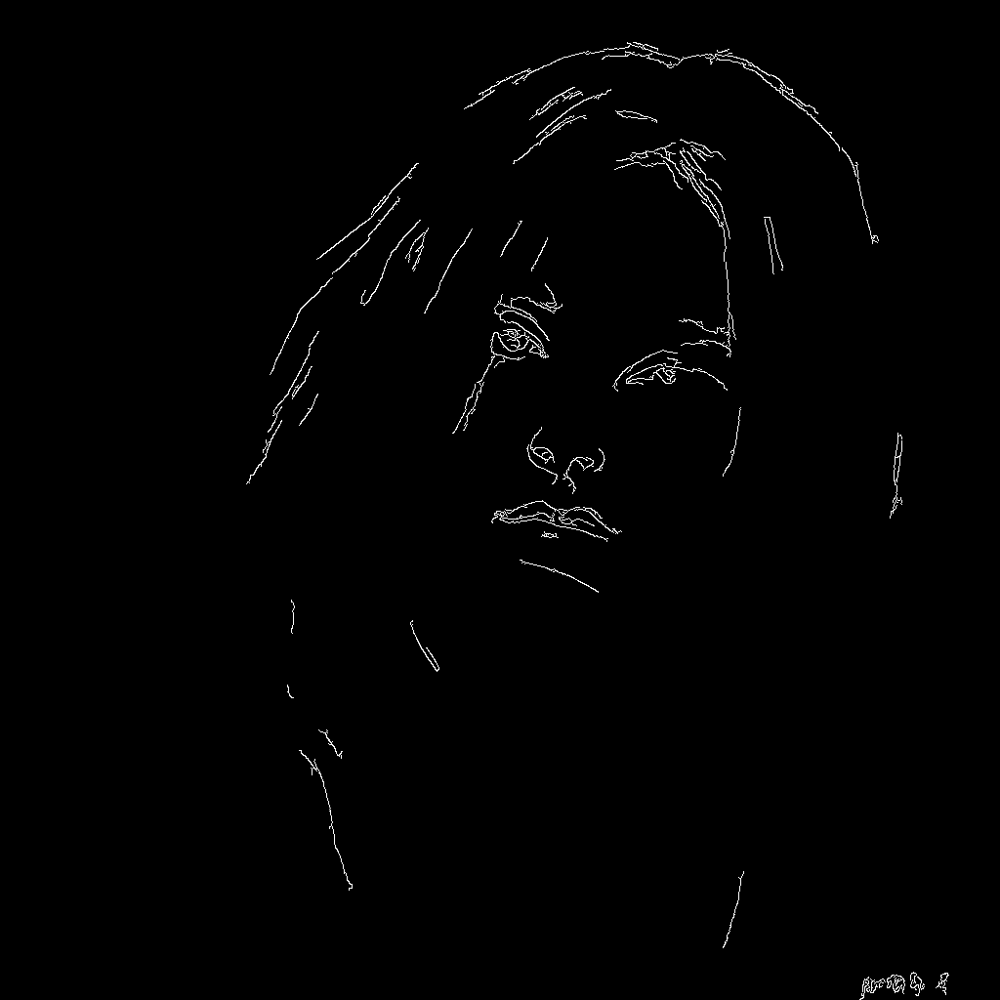

In [ ]:
import cv2
import numpy as np
from PIL import Image

image = np.array(ref_image)

low_threshold = 50
high_threshold = 200

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)
canny_image

Теперь будем использовать ControlNet для генерации изображения с учётом контура. Загружаем нужную нам модель `ControlNetModel` (использующую canny image), и затем `ControlNetPipeline` для генерации:

In [ ]:
import torch
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, LCMScheduler
from diffusers.utils import load_image

controlnet = ControlNetModel.from_pretrained("diffusers/controlnet-canny-sdxl-1.0-small", torch_dtype=torch.float16, variant="fp16")
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    torch_dtype=torch.float16,
    safety_checker=None,
    variant="fp16"
).to("cuda")

pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)

pipe.load_lora_weights("latent-consistency/lcm-lora-sdxl")
pipe.fuse_lora()


config.json:   0%|          | 0.00/1.26k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/320M [00:00<?, ?B/s]

Keyword arguments {'safety_checker': None} are not expected by StableDiffusionXLControlNetPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


Теперь в цикле генерируем изображения с разными цветами волос:

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

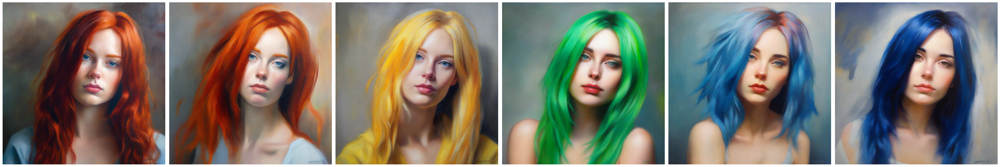

In [ ]:
colors = ['red','orange','yellow','green','blue','indigo']
res = []
for c in colors:
  image = pipe(
      prompt=f"oil painting of a beautiful girl with {c} hair, looking with attention into the camera, 8k",
      image=canny_image,
      num_inference_steps=5,
      guidance_scale=1.5,
      controlnet_conditioning_scale=0.5,
      cross_attention_kwargs={"scale": 1},
      ).images[0]
  res.append(image)

display_images(res)

## Квантизация и большие модели

В последнее время появляются очень "тяжелые" модели, например, FLUX, которые не могут выполняться на "бытовых" или условно-бесплатных GPU-ресурсах. Для того, чтобы все-таки иметь возможность использовать такие модели, применяют **квантизацию**. Для этого веса нейросети представляют не полноценными числами, а их "урезанными" вариантами - это снижает точность модели и слегка ухудшает результат, но позволяет уместить нейросеть в сравнительно небольшом объеме памяти.

Попробуем использовать квартизированную версию FLUX (инструкции взяты [с этой странички huggingface](https://huggingface.co/docs/diffusers/main/quantization/bitsandbytes?bnb=4-bit):

In [24]:
%pip install transformers diffusers bitsandbytes -U

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.7/69.7 MB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 58.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 95.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [1]:
from diffusers import BitsAndBytesConfig as DiffusersBitsAndBytesConfig
from transformers import BitsAndBytesConfig as TransformersBitsAndBytesConfig
import torch
from diffusers import FluxTransformer2DModel
from transformers import T5EncoderModel

quant_config = TransformersBitsAndBytesConfig(load_in_4bit=True,)

text_encoder_2_4bit = T5EncoderModel.from_pretrained(
    "black-forest-labs/FLUX.1-schnell",
    subfolder="text_encoder_2",
    quantization_config=quant_config,
    torch_dtype=torch.float16,
)

quant_config = DiffusersBitsAndBytesConfig(load_in_4bit=True,)

transformer_4bit = FluxTransformer2DModel.from_pretrained(
    "black-forest-labs/FLUX.1-schnell",
    subfolder="transformer",
    quantization_config=quant_config,
    torch_dtype=torch.float16,
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(
`low_cpu_mem_usage` was None, now default to True since model is quantized.


(…)encoder_2%2Fmodel.safetensors.index.json:   0%|          | 0.00/19.9k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.53G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

transformer%2Fconfig.json:   0%|          | 0.00/321 [00:00<?, ?B/s]

(…)ion_pytorch_model.safetensors.index.json:   0%|          | 0.00/121k [00:00<?, ?B/s]

Fetching 3 files:   0%|          | 0/3 [00:00<?, ?it/s]

(…)pytorch_model-00002-of-00003.safetensors:   0%|          | 0.00/9.95G [00:00<?, ?B/s]

(…)pytorch_model-00001-of-00003.safetensors:   0%|          | 0.00/9.96G [00:00<?, ?B/s]

(…)pytorch_model-00003-of-00003.safetensors:   0%|          | 0.00/3.87G [00:00<?, ?B/s]

In [2]:
  from diffusers import FluxPipeline

  pipe = FluxPipeline.from_pretrained(
    "black-forest-labs/FLUX.1-schnell",
    transformer=transformer_4bit.to("cuda"),
    text_encoder_2=text_encoder_2_4bit.to("cuda"),
    torch_dtype=torch.float16,
).to("cuda")

model_index.json:   0%|          | 0.00/536 [00:00<?, ?B/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer%2Ftokenizer_config.json:   0%|          | 0.00/705 [00:00<?, ?B/s]

tokenizer_2%2Fspecial_tokens_map.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

scheduler%2Fscheduler_config.json:   0%|          | 0.00/274 [00:00<?, ?B/s]

text_encoder%2Fconfig.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

tokenizer%2Fmerges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer%2Fspecial_tokens_map.json:   0%|          | 0.00/588 [00:00<?, ?B/s]

tokenizer%2Fvocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/168M [00:00<?, ?B/s]

tokenizer_2%2Ftokenizer_config.json:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

tokenizer_2%2Ftokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

vae%2Fconfig.json:   0%|          | 0.00/774 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


/usr/local/lib/python3.11/dist-packages/bitsandbytes/nn/modules.py:451: UserWarning: Input type into Linear4bit is torch.float16, but bnb_4bit_compute_dtype=torch.float32 (default). This will lead to slow inference or training speed.
  warnings.warn(


  0%|          | 0/2 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/bitsandbytes/nn/modules.py:446: UserWarning: Input type into Linear4bit is torch.float16, but bnb_4bit_compute_dtype=torch.float32 (default). This will lead to slow inference.
  warnings.warn(


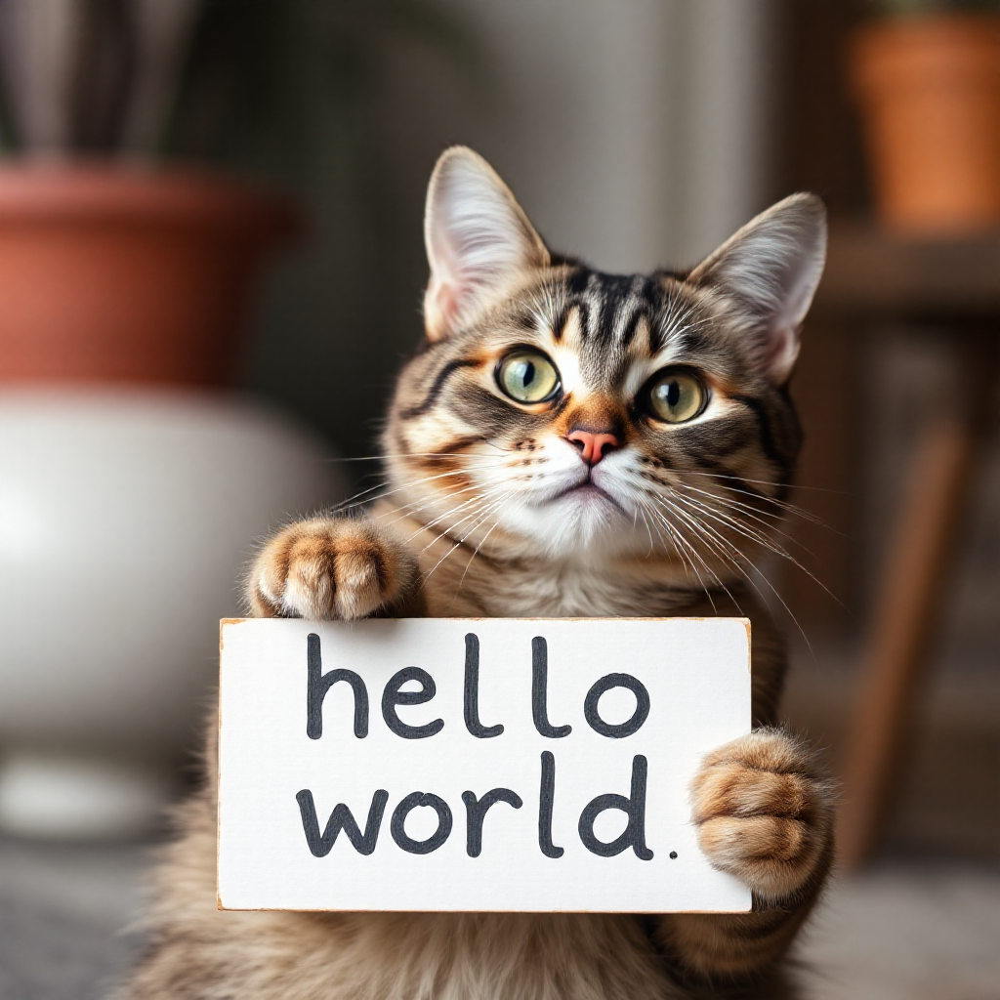

In [3]:
image = pipe("A cat holding a sign that says hello world",num_inference_steps=2,guidance_scale=0).images[0]
image

## Выводы

Использование моделей генерации изображений из программного кода позволяет автоматизировать генерацию изображений. Вам при этом доступно большое количество моделей с открытыми весами, включая модели, до-обучаемые сообществом. Кроме того, возможность "залезть внутрь" кода позволяет делать разные смелые эксперименты вроде генерации нейросетевого видео с помощью интерполяции пространства смыслов.